In [37]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
#import seaborn as sns
import torch
from torch.utils.data import Dataset, DataLoader
import os
import rasterio as rio

In [38]:
def return_label_output_names(metadata_path):
    metadata = pd.read_csv(metadata_path) 
    metadata = metadata[(metadata['set']=='test') & (metadata['learn_type']=='csl')]

    label_names = [f"l1c_csl_{metadata.iloc[i,0]}_label.tif" for i in range(len(metadata))]
    output_names = [f"{metadata.iloc[i,0]}.png" for i in range(len(metadata))]
    return label_names, output_names

In [40]:
# load filenames in a list end with .tif or .png
def load_filenames(path):
    filenames = []
    for root, dirs, files in os.walk(path):
        for file in files:
            if file.endswith(".tif") or file.endswith(".png"):
                filenames.append(os.path.join(root, file))
    return filenames

def check_order(labels, outputs):
    k=0
    for i,j in zip(outputs,labels):
        if str(i).replace(".png","") not in str(j):
            print(i,j)
            k+=1
    if k==0:
        print("All good!")
    return k

In [56]:
metadata_path = r'E:\Thesis\data\small\meta_patches.csv'

label_path = r"E:\Thesis\data\small\l1c\test"
outputs_paths = [   r"E:\Thesis\outputs\43772\model_outputs\predictions",
                    r"E:\Thesis\outputs\43771\model_outputs\predictions",
                    r"E:\Thesis\outputs\43775\model_outputs\predictions",
                    r"E:\Thesis\outputs\43776\model_outputs\predictions",
                    r"E:\Thesis\outputs\43777\model_outputs\predictions"]

In [57]:
labels,outputs = return_label_output_names(metadata_path)
check_order(labels,outputs)

All good!


0

In [58]:
color_legend = {
    0: (125, 125, 125),
    1: (65, 155, 223),
    2: (57, 125, 73),
    3: (136, 176, 83),
    4: (122, 135, 198),
    5: (228, 150, 53),
    6: (223, 195, 90),
    7: (196, 40, 27),
    8: (165, 155, 143),
    9: (179, 159, 225),
    10: (205, 205, 205)
}


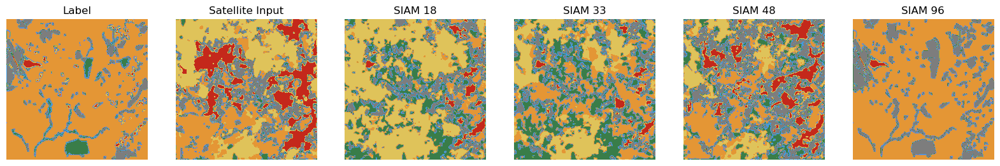

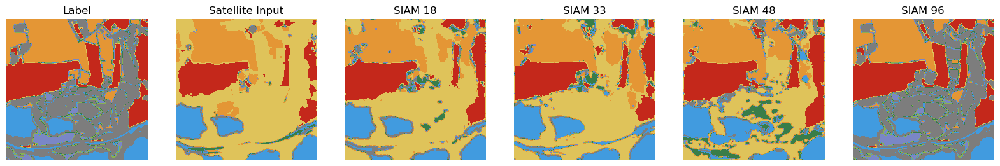

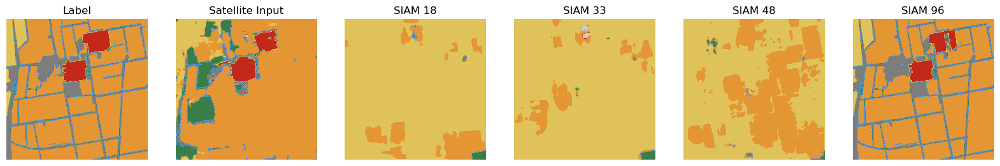

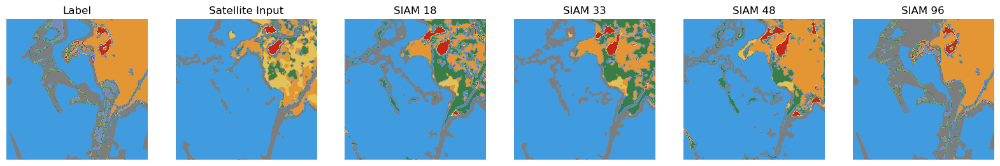

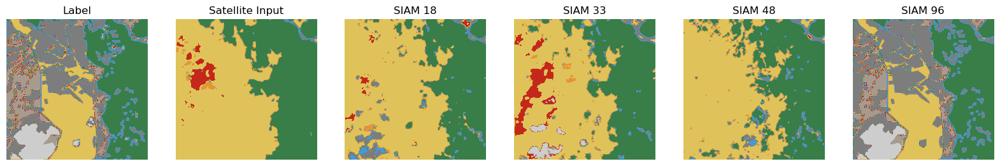

...

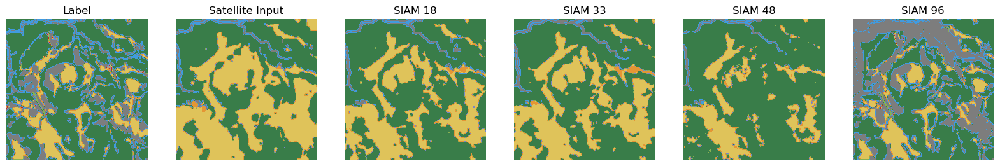

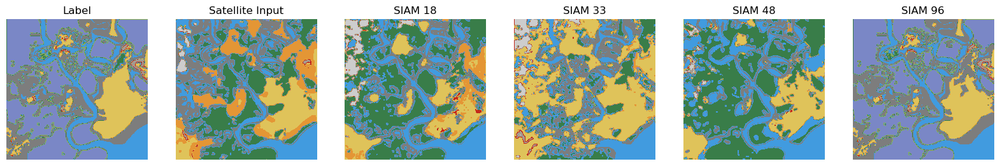

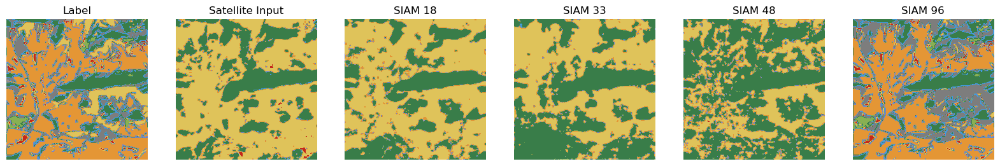

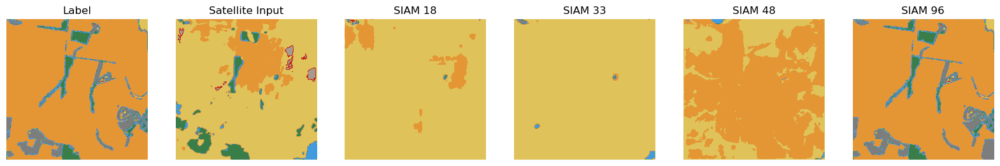

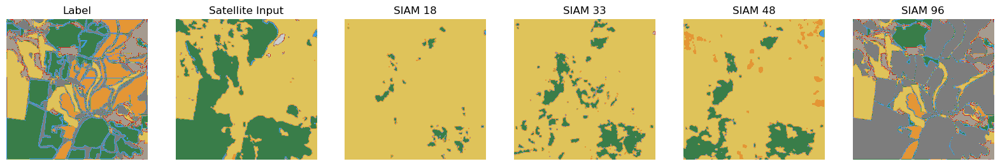

RasterioIOError: E:/Thesis/outputs/43772/model_outputs/predictions/133.0655_46.0380-20191022.png: No such file or directory

In [77]:
def plot_comparison(label_fn, output_fn, label_path, lis_output_paths, color_legend):
    for i in range(len(label_fn)):
        label = rio.open(os.path.join(label_path,label_fn[i])).read(7)
        output_1 = rio.open(os.path.join(lis_output_paths[0],output_fn[i]))
        output_2 = rio.open(os.path.join(lis_output_paths[1],output_fn[i]))
        output_3 = rio.open(os.path.join(lis_output_paths[2],output_fn[i]))
        output_4 = rio.open(os.path.join(lis_output_paths[3],output_fn[i]))
        output_5 = rio.open(os.path.join(lis_output_paths[4],output_fn[i]))
   
        fig, ax = plt.subplots(1, 6, figsize=(20, 10))
        # register colormap from legend
        cmap = plt.cm.colors.ListedColormap([np.array(color_legend[i]) / 255 for i in color_legend.keys()])
        bounds = list(color_legend.keys())
        norm = plt.cm.colors.BoundaryNorm(bounds, cmap.N)

        ax[0].imshow(label, cmap=cmap, norm=norm)
        ax[0].set_title("Label")
        ax[0].axis("off")

        names = ['Satellite Input', 'SIAM 18', 'SIAM 33','SIAM 48', 'SIAM 96' ]
        for i, output in enumerate([output_1, output_2, output_3, output_4, output_5]):
            ax[i + 1].imshow(output.read(1), cmap=cmap, norm=norm)
            ax[i + 1].set_title(f"{names[i]}")
            ax[i + 1].axis("off")

        plt.suptitle(f"Comparison of label and outputs for {label_fn[i].replace('.tif','')}")
        plt.show()

plot_comparison(labels, outputs, label_path, outputs_paths, color_legend)

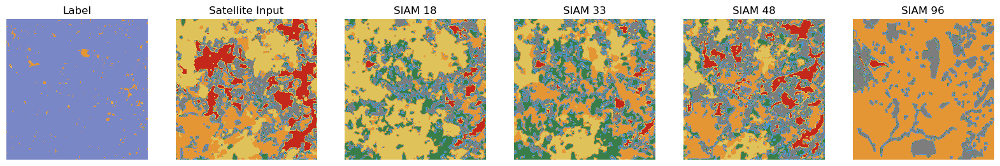

In [72]:
plot_comparison(labels, outputs, label_path, outputs_paths, color_legend)